# Create a Dataset for Sentiment Analysis

> TL;DR In this tutorial, you'll learn how to create a dataset for Sentiment Analysis by scraping user reviews for Android apps. You'll convert the app and review information into Data Frames and save that to CSV files.

- [Read the tutorial](https://www.curiousily.com/posts/create-dataset-for-sentiment-analysis-by-scraping-google-play-app-reviews-using-python/)
- [Run the notebook in your browser (Google Colab)](https://colab.research.google.com/drive/1GDJIpz7BXw55jl9wTOMQDool9m8DIOyp)
- [Read the `Getting Things Done with Pytorch` book](https://github.com/curiousily/Getting-Things-Done-with-Pytorch)

You'll learn how to:

- Set a goal and inclusion criteria for your dataset
- Get real-world user reviews by scraping Google Play
- Use Pandas to convert and save the dataset into CSV files

## Setup

Let's install the required packages and setup the imports:

In [1]:
!pip install -qq google-play-scraper

In [2]:
!pip install -qq -U watermark

In [3]:
%reload_ext watermark
%watermark -v -p pandas,matplotlib,seaborn,google_play_scraper

Python implementation: CPython
Python version       : 3.10.6
IPython version      : 8.14.0

pandas             : 2.0.3
matplotlib         : 3.7.2
seaborn            : 0.12.2
google_play_scraper: 1.2.4



In [4]:
import json
import pandas as pd
from tqdm import tqdm

import seaborn as sns
import matplotlib.pyplot as plt

from pygments import highlight
from pygments.lexers import JsonLexer
from pygments.formatters import TerminalFormatter

from google_play_scraper import Sort, reviews, app

%matplotlib inline
%config InlineBackend.figure_format='retina'

sns.set(style='whitegrid', palette='muted', font_scale=1.2)

## The Goal of the Dataset

You want to get feedback for your app. Both negative and positive are good. But the negative one can reveal critical features that are missing or downtime of your service (when it is much more frequent).

Lucky for us, Google Play has plenty of apps, reviews, and scores. We can scrape app info and reviews using the [google-play-scraper](https://github.com/JoMingyu/google-play-scraper) package.

You can choose plenty of apps to analyze. But different app categories contain different audiences, domain-specific quirks, and more. We'll start simple.

We want apps that have been around some time, so opinion is collected organically. We want to mitigate advertising strategies as much as possible. Apps are constantly being updated, so the time of the review is an important factor.

Ideally, you would want to collect every possible review and work with that. However, in the real world data is often limited (too large, inaccessible, etc). So, we'll do the best we can.

Let's choose some apps that fit the criteria from the *Productivity* category. We'll use [AppAnnie](https://www.appannie.com/apps/google-play/top-chart/?country=US&category=29&device=&date=2020-04-05&feed=All&rank_sorting_type=rank&page_number=1&page_size=100&table_selections=) to select some of the top US apps:

In [5]:
app_packages = [
  'com.jago.digitalBanking',
  'com.btpn.dc',
  'id.bmri.livin',
  'com.bcadigital.blu',
  'com.bnc.finance',
  'com.alloapp.yump',
  'id.co.linebank',
  'com.mnc.mbanking',
  'id.co.bankraya.apps',
  'com.bank.danamon'
]
# app_packages = [
#   'com.garena.game.codm',
#   'com.tencent.ig',
#   'com.dts.freefireth',
#   'com.AlfaBravo.CombatMaster',
#   'com.GlobalSoFunny.Sausage',
#   # 'com.alloapp.yump',
#   # 'id.co.linebank',
#   # 'com.mnc.mbanking',
#   # 'id.co.bankraya.apps',
#   # 'com.bank.danamon'
# ]

## Scraping App Information

Let's scrape the info for each app:

In [7]:
app_infos = []

for ap in tqdm(app_packages):
  info = app(ap, lang='en', country='id')
  # del info['comments']
  app_infos.append(info)

100%|██████████| 10/10 [00:02<00:00,  4.64it/s]


We got the info for all 15 apps. Let's write a helper function that prints JSON objects a bit better:

In [8]:
print(app_infos);

[{'title': 'Jago/Jago Syariah digital bank', 'description': "Jago/Jago Syariah is a digital financial application that offers a practical solution that enables you to spend & save with those closest to you the way you want.\r\n\r\nWhy use Jago?\r\n\r\n- Licensed & supervised by Financial Services Authority (OJK) & also a member of LPS deposit insurance program\r\n- Available in 2 options: Jago & Jago Syariah, a full-featured digital Shariah bank that is simple and safe according to the Wadiah Akad (no interest) and akad Mudharabah (competitive profit sharing)\r\n- Offers deposit for long-term saving with up to 5% interest rate & is flexible to be withdrawn at any time without penalties\r\n- Open a Jago account in minutes via smartphone, with no minimum balance & no need to go to the bank\r\n- Manage spending & saving in one app\r\n- Easily contact Jago 24 hours a day, 7 days a week at 1500 746 / 021 30000746\r\n- Integrated with financial applications such as Bibit, Gobiz, GoPay & more

In [9]:
def print_json(json_object):
  json_str = json.dumps(
    json_object, 
    indent=2, 
    sort_keys=True, 
    default=str
  )
  print(highlight(json_str, JsonLexer(), TerminalFormatter()))

Here is a sample app information from the list:

In [10]:
print_json(app_infos[0])

{
  "adSupported": false,
  "appId": "com.jago.digitalBanking",
  "categories": [
    {
      "id": "FINANCE",
      "name": "Finance"
    }
  ],
  "comments": [
    "\"Spend Analysis\" feature is really spotty. Occasionally manual adjustments works, but more often than not it doesn't work at all. The app /still/ doesn't show cents, despite seemingly using them behind-the-scene, leading to a very small difference between the balance shown on the app vs. what you would have if you calculated your transaction manually, as you can only see up to ones and not cents. Every other banking app I used shows cents values, because they value transparency and accuracy.",
    "This app is the real digital bank. It is easy to use, has a nice design, and it is really helpful for the millenials with its sharing feature. I'm giving four stars because there is still a room for improvement in the pocket feature. Unlike normal transfer where we can give description, unfortunately, this is not the case whe

This contains lots of information including the number of ratings, number of reviews and number of ratings for each score (1 to 5). Let's ignore all of that and have a look at their beautiful icons:

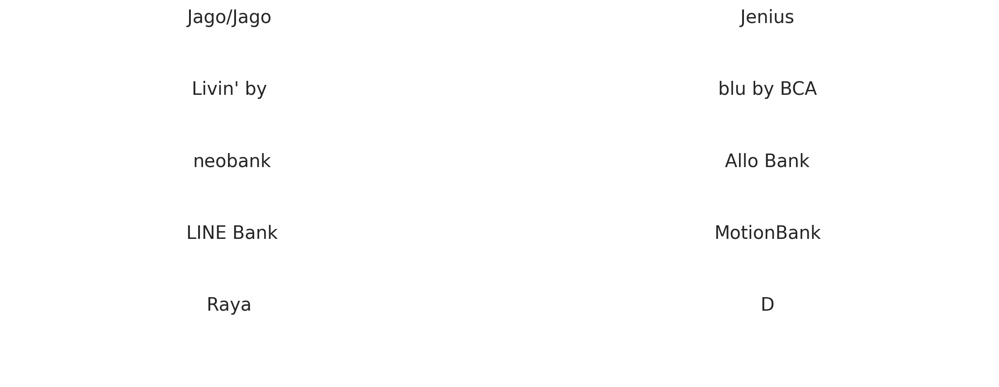

In [11]:
def format_title(title):
  sep_index = title.find(':') if title.find(':') != -1 else title.find('-')
  if sep_index != -1:
    title = title[:sep_index]
  return title[:10]

fig, axs = plt.subplots(5, len(app_infos) // 5, figsize=(14, 5))

for i, ax in enumerate(axs.flat):
  ai = app_infos[i]
  # img = plt.imread(ai['icon'])
  # ax.imshow(img)
  ax.set_title(format_title(ai['title']))
  ax.axis('off')

We'll store the app information for later by converting the JSON objects into a Pandas dataframe and saving the result into a CSV file:

In [12]:
app_infos_df = pd.DataFrame(app_infos)
app_infos_df.to_csv('apps-mobile-banking-2023.csv', index=None, header=True)

## Scraping App Reviews

In an ideal world, we would get all the reviews. But there are lots of them and we're scraping the data. That wouldn't be very polite. What should we do?

We want:

- Balanced dataset - roughly the same number of reviews for each score (1-5)
- A representative sample of the reviews for each app

We can satisfy the first requirement by using the scraping package option to filter the review score. For the second, we'll sort the reviews by their helpfulness, which are the reviews that Google Play thinks are most important. Just in case, we'll get a subset from the newest, too:

In [13]:
app_reviews = []

for ap in tqdm(app_packages):
  for score in list(range(1, 6)):
    for sort_order in [Sort.MOST_RELEVANT, Sort.NEWEST]:
      rvs, _ = reviews(
        ap,
        lang='en',
        country='id',
        sort=sort_order,
        count= 200 if score == 3 else 100,
        filter_score_with=score
      )
      for r in rvs:
        r['sortOrder'] = 'most_relevant' if sort_order == Sort.MOST_RELEVANT else 'newest'
        r['appId'] = ap
      app_reviews.extend(rvs)

100%|██████████| 10/10 [00:34<00:00,  3.46s/it]


Note that we're adding the app id and sort order to each review. Here's an example for one:

In [14]:
print_json(app_reviews[1])

{
  "appId": "com.jago.digitalBanking",
  "appVersion": "8.17.0",
  "at": "2023-04-25 09:22:20",
  "content": "Please fix the app. It's sooo lagging to move the money, transfer, basically for doing any operation, even when the connection is fine. If there is bank digital that offer pocket feature, I will move on from Jago to be honest. The only thing make me stay is the pocket feature since I have numerous saving/spending sections.",
  "repliedAt": "2023-04-25 18:20:50",
  "replyContent": "Hello, Jagoan! We apologize if there are Jago features or services that have not met your expectations. You can contact Tanya Jago at 1500746 / 021-30000746 or e-mail to tanya@jago.com to help us check the problem further. Our agents are happy to help you.",
  "reviewCreatedVersion": "8.17.0",
  "reviewId": "5b9748be-c910-4630-b94a-cf2f4a5d3b59",
  "score": 1,
  "sortOrder": "most_relevant",
  "thumbsUpCount": 13,
  "userImage": "https://play-lh.googleusercontent.com/a-/AD_cMMQ4K-dG8OW7vGJx48HdQppvVD

`repliedAt` and `replyContent` contain the developer response to the review. Of course, they can be missing.

How many app reviews did we get?



In [15]:
len(app_reviews[0])

13

In [16]:
print_json(app_reviews)

[
  {
    "appId": "com.jago.digitalBanking",
    "appVersion": "8.16.0",
    "at": "2023-04-11 15:50:51",
    "content": "\"Spend Analysis\" feature is really spotty. Occasionally manual adjustments works, but more often than not it doesn't work at all. The app /still/ doesn't show cents, despite seemingly using them behind-the-scene, leading to a very small difference between the balance shown on the app vs. what you would have if you calculated your transaction manually, as you can only see up to ones and not cents. Every other banking app I used shows cents values, because they value transparency and accuracy.",
    "repliedAt": "2023-01-03 12:38:58",
    "replyContent": "Hello Jagoan! Sorry for the inconvinience you experienced. You can provide detailed information about the problem you are facing by contacting Tanya Jago at 1500746 /+62 21 3000 0746 or e-mail to tanya@jago.com. Our agents will be happy to help you.",
    "reviewCreatedVersion": "8.16.0",
    "reviewId": "08ea51f8

Let's save the reviews to a CSV file:

In [2]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)
#repo_path = '/content/gdrive/My Drive/reviewsentimen2021/'

Mounted at /content/drive


In [35]:
app_reviews_df = pd.DataFrame(app_reviews)
app_reviews_df.to_csv('review_mobile-banking_2023.csv', index=None, header=True)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Summary

Well done! You now have a dataset with more than 15k user reviews from 15 productivity apps. Of course, you can go crazy and get much much more.

- [Read the tutorial](https://www.curiousily.com/posts/create-dataset-for-sentiment-analysis-by-scraping-google-play-app-reviews-using-python/)
- [Run the notebook in your browser (Google Colab)](https://colab.research.google.com/drive/1GDJIpz7BXw55jl9wTOMQDool9m8DIOyp)
- [Read the `Getting Things Done with Pytorch` book](https://github.com/curiousily/Getting-Things-Done-with-Pytorch)

You learned how to:

- Set goals and expectations for your dataset
- Scrape Google Play app information
- Scrape user reviews for Google Play apps
- Save the dataset to CSV files

Next, we're going to use the reviews for sentiment analysis with BERT. But first, we'll have to do some text preprocessing!


## References

- [Google Play Scraper for Python](https://github.com/JoMingyu/google-play-scraper)

# New Section